# continue

#### Separate banks by size
Small - intermediate - large 

Once you have banks that have failed by size
thens start creating docaeirs of banks that failed by size
- small banks failed because they dont

- Call report --> python program script to look for sspecific data im looking for to a speciic excel sheet

- bulld profiles of every bank, demand deposit accounts are liabilities, loan accounts assets anything,

- smaller banks may never touch mortgage backed securities because their much riskier, larger banks invests in those products becuase their riskier and offer larger returns. look into investments, because baks that failed prior to 2008 might have similar discrepanices to banks that failed. Look at investments but youd have to understand the securites 

In [121]:
import pandas as pd
import os
import missingno as msno
import janitor
import numpy as np
import plotly.express as px

In [3]:
df_bank_failure_inactive= pd.read_parquet(r"C:\Users\jesus\Desktop\data\bank_data_failed_inactive.parquet")


## Seperating by Bank size

### Different banks react to different things.
#### Smaller banks are more risk averse so they are less likely to invest in risky financial assets such as mortgage loans. Because their risk is different, it is extremely crucial to distinguish betwen small - intermediate = large banks. Because the risk profile differ from bank to bank (largely dependent on bank size) I otped to use FDIC's own description of [small to intermediate asset size treshhold](https://www.ffiec.gov/sites/default/files/data/cra/pdf/2025_Asset_Size_Threshold.pdf). Their is also a short 2024 [press release](https://www.fdic.gov/news/press-releases/2024/agencies-release-annual-asset-size-thresholds-under-community-reinvestment) I looked at. For future, merge all 


##### Intermediate small Banks: 0 - 376 million

##### Small Banks: 376 million - $1.503 billion

##### Large Banks: assets > $1.503 billion



#### *making it easy to find variable names*

In [17]:
path = r"C:\Users\jesus\Downloads\VariableDefinitions.csv"
df_def = pd.read_csv(path)
df_def.columns = df_def.columns.str.strip().str.upper()

In [ ]:
def get_var_name(var_name):
    """Function used to lookup variable name from Variable definitions.csv provided"""
    columns_all = df_def.columns

    if var_name == 

In [27]:
#I quickly used chatGPT to form this convenient variable finder function

def get_variable_definition(var_name):
    """
    Look up a variable's definition from your FFIEC variable definition file.
    Example: get_variable_definition("RCFD2170")
    """
    # Clean up and normalize
    df_def.columns = ['variable_code', 'definition']
    var_name = var_name.strip().upper()

    # Look for exact match
    match = df_def[df_def['variable_code'].astype(str).str.upper() == var_name]

    if not match.empty:
        definition = match['definition'].iloc[0]
        print(f"🟩 Variable: {var_name}")
        print(f"🧾 Definition: {definition}")
    else:
        print(f"No definition found for '{var_name}'. Check the variable name or source.")


#### Seperating by bank size
##### We have two total asset variables, one represents foreign + domestic (RCFD) and the other represents domestic assets (RCON). I need to combine these two variables into one [total assets] column. I need to do it in a way that avoids double counting, so if a bank already has RCFD then that should be used, if not then RCON should be used. 

###### [numpy.where](https://numpy.org/doc/stable/reference/generated/numpy.where.html) helpes me simplify this from a for looop with if else statments. Condition array_like, bool Where True, yield x, otherwise yield y.

In [33]:
get_variable_definition("RCON2170") 

get_variable_definition("RCFD2170") 

## Dr. Bieri
# assets = "RCON2170" # TOTAL ASSETS - 4875 banks are na in this column
# equity = "RCON3210" # TOTAL EQUITY CAPITAL - 8759 banks are na in this column

# It appears that maybe this information is reported in a different column for some banks.
# I will drop data that is NaN in these columns

###RCON represents banks who only operate domestically 
#RCFD represents banks who operate domestically and foreign 


🟩 Variable: RCON2170
🧾 Definition: TOTAL ASSETS
🟩 Variable: RCFD2170
🧾 Definition: TOTAL ASSETS


In [50]:
filled_in = df_bank_failure_inactive['RCFD2170'].notna()
filled_in

0         False
1         False
2         False
3         False
4         False
          ...  
591109    False
591110    False
591111    False
591112    False
591113    False
Name: RCFD2170, Length: 591114, dtype: bool

In [49]:
df_bank_failure_inactive["RCFD2170"].describe()
#weird dtype

count    8.759000e+03
mean     1.053984e+08
std      3.153003e+08
min      4.264000e+03
25%      1.503772e+06
50%      1.269419e+07
75%      6.981360e+07
max      3.476711e+09
Name: RCFD2170, dtype: float64

In [48]:
df_bank_failure_inactive["RCFD2170"] = pd.to_numeric(df_bank_failure_inactive["RCFD2170"], errors="coerce")

In [225]:
filled_in = df_bank_failure_inactive["RCFD2170"].notna()
df_bank_failure_inactive['total_assets'] = np.where (filled_in, df_bank_failure_inactive["RCFD2170"], df_bank_failure_inactive["RCON2170"]) 
#Should I be doing this with every RCFD and RCON, RIAD4340 appears 4 times

In [226]:
df_bank_failure_inactive[["RCFD2170", "RCON2170", "total_assets"]].isna().sum()

# 0 NaN perfect.


RCFD2170        582355
RCON2170          4875
total_assets         0
dtype: int64

In [65]:
dd = list(df_bank_failure_inactive.columns)
print(dd)

['Reporting Period End Date', 'IDRSSD', 'FDIC Certificate Number', 'OCC Charter Number', 'OTS Docket Number', 'Primary ABA Routing Number', 'Financial Institution Name', 'Financial Institution Address', 'Financial Institution City', 'Financial Institution State', 'Financial Institution Zip Code', 'Financial Institution Filing Type', 'Last Date/Time Submission Updated On', 'RIAD4180', 'RIAD4185', 'RIAD4200', 'RIAD4217', 'RIAD4230', 'RIAD4300', 'RIAD4301', 'RIAD4302', 'RIAD4313', 'RIAD4320', 'RIAD4340', 'RIAD4507', 'RIAD4508', 'RIAD4513', 'RIAD4518', 'RIAD5415', 'RIAD5416', 'RIAD8431', 'RIAD8757', 'RIAD8758', 'RIAD8759', 'RIAD8760', 'RIAD8761', 'RIAD8762', 'RIAD8763', 'RIAD9106', 'RIADA220', 'RIADA251', 'RIADA517', 'RIADA518', 'RIADA530', 'RIADB485', 'RIADB486', 'RIADB487', 'RIADB488', 'RIADB489', 'RIADB490', 'RIADB491', 'RIADB492', 'RIADB493', 'RIADB494', 'RIADB496', 'RIADB497', 'RIADC216', 'RIADC232', 'RCFD0071', 'RCFD0081', 'RCFD0426', 'RCFD1248', 'RCFD1249', 'RCFD1250', 'RCFD1251', '

In [68]:
df_bank_failure_inactive['closing_date_'].info

<bound method Series.info of 0         None
1         None
2         None
3         None
4         None
          ... 
591109    None
591110    None
591111    None
591112    None
591113    None
Name: closing_date_, Length: 591114, dtype: object>

In [70]:
df_bank_failure_inactive['closing_date_'] = pd.to_datetime(df_bank_failure_inactive['closing_date_'], yearfirst=True)
df_bank_failure_inactive['closing_date_'].dtype

dtype('<M8[ns]')

In [79]:
df_bank_failure_inactive['closing_date_'].isna().sum() # so 574491 banks didn't fail

np.int64(574491)

In [88]:
df_bank_failure_inactive['RIAD4340'].describe() #0 NaN
get_variable_definition("RIAD4340") 


🟩 Variable: RIAD4340
🧾 Definition: NET INCOME


### With Total assets figured out, now seperate by sizes

##### Its worth asking Dr. Bieri --> I'm confident RCON is domestic banks only, RCFN is foreign data, while RCFD is total of entire insitution so foreign + domestic offices)

**[RCFD       =   RCON   +  RCFN](https://www.federalreserve.gov/apps/mdrm/about_mdrm.htm)**

$consolidated = domestic + foreign$

#Earlier RCFD had significant NaN values because not all banks are required to file it, only bsnkd with foreign offices. 

In [118]:
df_bank_failure_inactive['total_assets'] = pd.to_numeric(df_bank_failure_inactive['total_assets'], errors='coerce')
df_bank_failure_inactive['total_assets'].describe()

count    5.911140e+05
mean     2.194617e+06
std      4.055663e+07
min      0.000000e+00
25%      7.206100e+04
50%      1.567920e+05
75%      3.812020e+05
max      3.476711e+09
Name: total_assets, dtype: float64

In [164]:
bins = [0, 376_000_000, 1_503_000_000, float('inf')]
label = ['intermediate_small_banks','small_banks','large_banks']

bank_categories = pd.cut(df_bank_failure_inactive['total_assets'], bins, labels = label)
df_bank_failure_inactive['bank_size'] = bank_categories

df_bank_failure_inactive.head(1)


,Reporting Period End Date,IDRSSD,FDIC Certificate Number,OCC Charter Number,OTS Docket Number,Primary ABA Routing Number,Financial Institution Name,Financial Institution Address,Financial Institution City,Financial Institution State,...,inactive_banks,name,city,state,cert,id_number,end_date,Unnamed: 6,total_assets,bank_size
0,2002-12-31,37.0,10057.0,0.0,16553.0,61107146.0,BANK OF HANCOCK COUNTY,321 BROAD STREET,SPARTA,GA,...,0,None,None,None,NaN,NaN,None,NaN,74327.0,intermediate_small_banks


In [133]:
# Get the list of ages
ages = [20, 22, 25, 27, 21, 23, 37, 31, 61, 45, 41, 32]
# Choose the edges of  your bins
# Here we will do 18 and under, 19-24, 25-34, ....
bins = [18, 25, 35, 60, 100]
# Have pandas cut the data into bins
age_categories = pd.cut(ages, bins)
age_categories

data = pd.DataFrame()
data['age'] = ages
data['range'] = age_categories
data

In [ ]:
#only uses a singular scalar import math

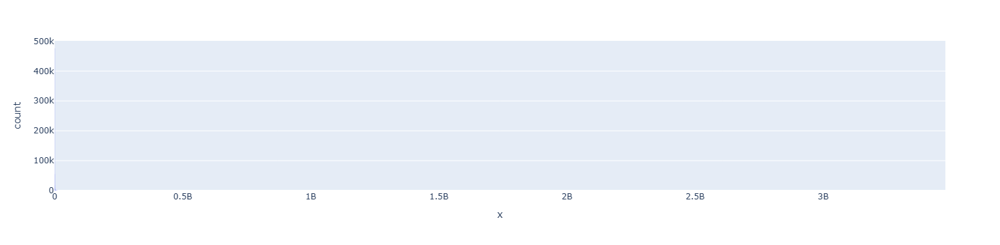

In [141]:
#Heavily right skewed because of the large banks, the majority of banks are small

notnormal = df_bank_failure_inactive['total_assets']

fig = px.histogram(x=notnormal)
fig.update_layout(bargap=0.1)
fig.show()

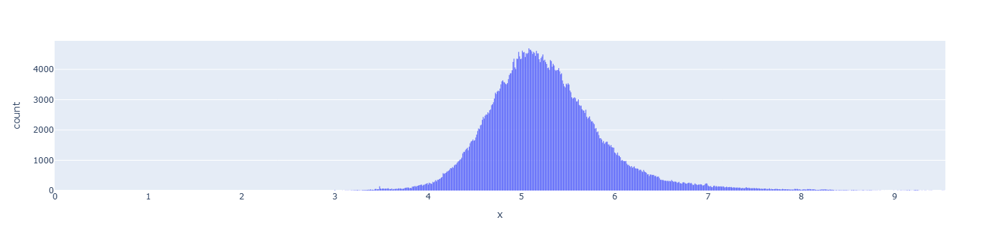

In [140]:
normal = np.log10(notnormal + 1) # without + 1 log wont work so i'd prefer to just have a normal distribution but shifted to the right

fig = px.histogram(x=normal)
fig.update_layout(bargap=0.1)
fig.show()   
  #The majoirty of banks are medium sized banks, 10^6 = 1,000,000

### Working with the whole dataset, we may be able to condense RCFN and RCON into RCFD so were not looking at so many variables. 

##### RCON2200 measures total deposits, we are only given RCFN (foreign) and RCON 2200 (domestic). Only companys who operate in foreign countries are required to file RCFN (foreign). Companys who file both foreign and domestic are required to file RCFD, so when given RCFN and RCON we can just add them to create the column RCFD 

In [102]:
df_bank_failure_inactive[['total_assets','RCON2170','RCFD2170']].head(10)

,total_assets,RCON2170,RCFD2170
0,74327,74327,NaN
1,25737,25737,NaN
2,132091,132091,NaN
3,8408,8408,NaN
4,150496,150496,NaN
5,23055,23055,NaN
6,263269,263269,NaN
7,367904,367904,NaN
8,130778,130778,NaN
9,95109,95109,NaN


## Condense RCFN and RCON into RCFD

In [ ]:
filled_in = df_bank_failure_inactive["RCFD2170"].notna()
df_bank_failure_inactive['total_assets'] = np.where (filled_in, df_bank_failure_inactive["RCFD2170"], df_bank_failure_inactive["RCON2170"]) 

In [229]:
import re

tt=list(df_bank_failure_inactive.columns)
needed = []
for i in tt:
    if i.startswith(('RCFD', 'RCFN', 'RCON')):
        if re.match(r'^(RCFD|RCON|RCFN)\d+$', i):
            needed.append(i)


code= []
for n in needed:
    last_four = n[4:]
    code.append(last_four)


print(len(needed))
print(len(code))


181
181
2143


In [231]:
for col in code:
    tot = f"RCFD{col}"
    dom = f"RCON{col}"
    foreign = f"RCFN{col}"
    if tot in df_bank_failure_inactive.columns:
        filled_in = df_bank_failure_inactive[tot].notna()
        df_bank_failure_inactive[col] = np.where (filled_in, df_bank_failure_inactive[tot], df_bank_failure_inactive[dom]) 

    elif dom in df_bank_failure_inactive.columns and foreign in df_bank_failure_inactive.columns:
        df_bank_failure_inactive[col] = df_bank_failure_inactive[dom] + df_bank_failure_inactive[foreign]

    else:
        print(f'cannot work with {tot}, {dom}, {foreign}') 





C:\Users\jesus\anaconda3\Lib\site-packages\executing\executing.py:713: DeprecationWarning:

ast.Str is deprecated and will be removed in Python 3.14; use ast.Constant instead

C:\Users\jesus\anaconda3\Lib\ast.py:602: DeprecationWarning:

Constant.__init__ got an unexpected keyword argument 's'. Support for arbitrary keyword arguments is deprecated and will be removed in Python 3.15.

C:\Users\jesus\anaconda3\Lib\ast.py:602: DeprecationWarning:

Attribute s is deprecated and will be removed in Python 3.14; use value instead

C:\Users\jesus\anaconda3\Lib\ast.py:602: DeprecationWarning:

Constant.__init__ missing 1 required positional argument: 'value'. This will become an error in Python 3.15.

C:\Users\jesus\anaconda3\Lib\site-packages\executing\executing.py:713: DeprecationWarning:

ast.Str is deprecated and will be removed in Python 3.14; use ast.Constant instead

C:\Users\jesus\anaconda3\Lib\ast.py:602: DeprecationWarning:

Constant.__init__ got an unexpected keyword argument 's'. Su

KeyError: 'RCON1251'

# create dummy variables based on bank size

In [172]:
df_bank_failure_inactive['intermediate_small_banks'] = (df_bank_failure_inactive['bank_size']=='intermediate_small_banks').astype(int) #0-376m
df_bank_failure_inactive['small_banks'] = (df_bank_failure_inactive['bank_size']=='small_banks').astype(int)                           # 376 - 1.5b
df_bank_failure_inactive['large_banks'] = (df_bank_failure_inactive['bank_size']=='large_banks').astype(int)                            #1.5b - infinity

In [173]:
df_bank_failure_inactive.head(1)

,Reporting Period End Date,IDRSSD,FDIC Certificate Number,OCC Charter Number,OTS Docket Number,Primary ABA Routing Number,Financial Institution Name,Financial Institution Address,Financial Institution City,Financial Institution State,...,state,cert,id_number,end_date,Unnamed: 6,total_assets,bank_size,intermediate_small_banks,small_banks,large_banks
0,2002-12-31,37.0,10057.0,0.0,16553.0,61107146.0,BANK OF HANCOCK COUNTY,321 BROAD STREET,SPARTA,GA,...,None,NaN,NaN,None,NaN,74327.0,intermediate_small_banks,1,0,0
